In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from lib.imports import *
from lib.tools import *
from lib.ipyjobs import *
from lib.data import *
from lib.utils import *
from lib.modules import *
from lib.functions import *
from ipynb.fs.defs.losses import *

In [3]:
G_list = load_G_list(data_path='data/rome', index_file='data_index.txt', cache='G_list', cache_prefix='cache/')

Load from 'cache/G_list.pickle'


In [4]:
data_list = generate_data_list(G_list, cache='data_list', cache_prefix='cache/')

Load from 'cache/data_list.pickle'


In [3]:
inputs = '''
digraph D {

  A [shape=diamond]
  B [shape=box]
  C [shape=circle]

  A -> B [style=dashed, color=grey]
  A -> C [color="black:invis:black"]
  A -> D [penwidth=5, arrowhead=none]

}
'''

In [7]:
outputs = subprocess.check_output([f'hde/pmds'], text=True, input=inputs)

eigs[0]=107495391.071795
eigs[1]=107487122.091041
wrote precision/recall in file /tmp/recall.txt
wrote precision/recall in file /tmp/precision.txt
sne_disimilarity = 0.021748
sstress per edge = 0.005128
final full stress = 0.030770
scaling factor = 0.923452
statistics for (null) cpu=     0.000
scale=0.000000


In [8]:
print(outputs)

digraph D {
	A	[pos="-0.000135,0.002141",
		shape=diamond];
	B	[pos="-28.029900,78.268596",
		shape=box];
	A -> B	[color=grey,
		style=dashed];
	C	[pos="81.799535,-14.861181",
		shape=circle];
	A -> C	[color="black:invis:black"];
	D	[pos="-53.769501,-63.409556"];
	A -> D	[arrowhead=none,
		penwidth=5];
}



In [ ]:
executor = concurrent.futures.ThreadPoolExecutor(16)
gt_pos = list(tqdm(map(get_pmds_layout, data_list, G_list), total=len(G_list)))

  0%|          | 0/11531 [00:00<?, ?it/s]

eigs[0]=32224552559.208611
eigs[1]=6604235234.132028
wrote precision/recall in file /tmp/recall.txt
wrote precision/recall in file /tmp/precision.txt
sne_disimilarity = 0.911435
sstress per edge = 0.092599
final full stress = 11.111840
scaling factor = 0.987661
statistics for (null) cpu=     0.001
scale=0.000000
eigs[0]=588379558841.877197
eigs[1]=121110576740.401443
wrote precision/recall in file /tmp/recall.txt
wrote precision/recall in file /tmp/precision.txt
sne_disimilarity = 6.386529
sstress per edge = 0.076442
final full stress = 48.158322
scaling factor = 1.110911
statistics for (null) cpu=     0.003
scale=0.000000
eigs[0]=1783467349589.641846
eigs[1]=1113953726616.197754
wrote precision/recall in file /tmp/recall.txt
wrote precision/recall in file /tmp/precision.txt
sne_disimilarity = 34.022589
sstress per edge = 0.083747
final full stress = 163.558744
scaling factor = 1.173247
statistics for (null) cpu=     0.012
scale=0.000000
eigs[0]=1131653881741.640625
eigs[1]=61818054134

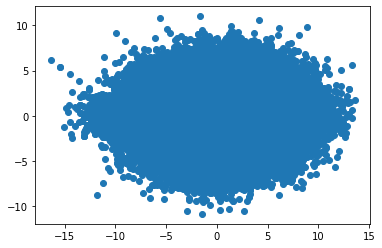

In [9]:
plt.scatter(np.concatenate(gt_pos)[:, 0], np.concatenate(gt_pos)[:, 1])

In [10]:
np.save('data/rome/pmds.npy', list(map(np.array, gt_pos)))

/usr/local/anaconda3/lib/python3.9/site-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


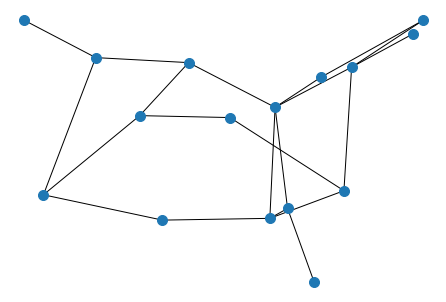

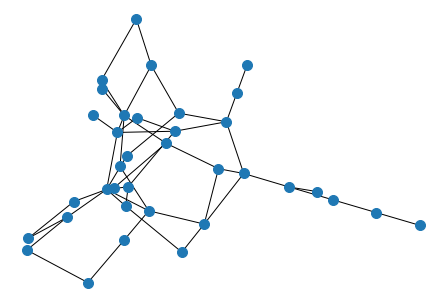

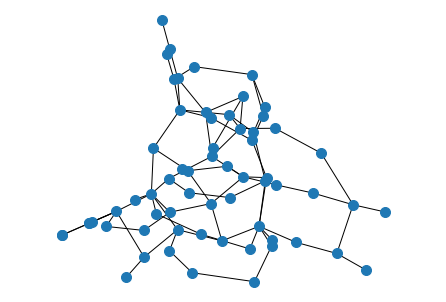

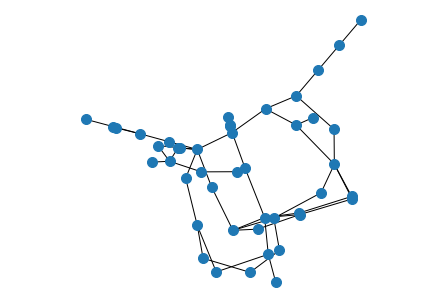

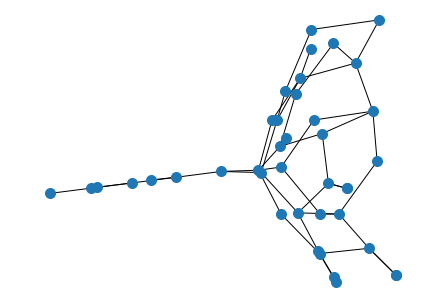

...

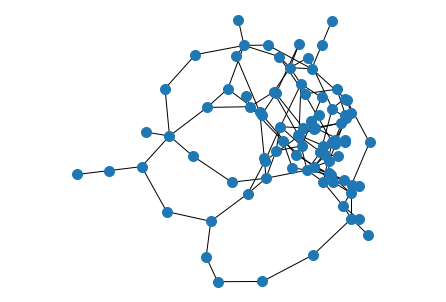

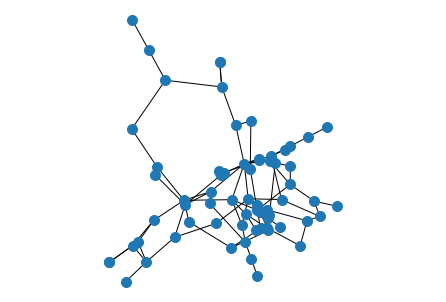

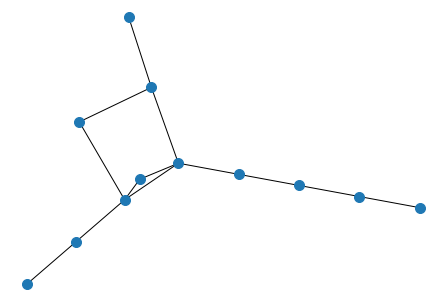

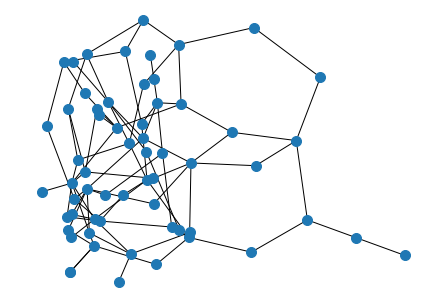

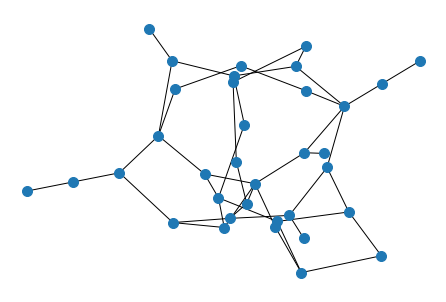

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [11]:
for pos, G in zip(gt_pos, G_list):
    graph_vis(G, pos)
    plt.show()

In [80]:
scalability = pd.read_csv(f"scalability.csv", index_col="index")

In [99]:
(idx, row), *_ = scalability.iterrows()

In [9]:
def load_mtx(file):
    data = scipy.io.mmread(file)
    G = nx.from_scipy_sparse_matrix(data)
    return G

  0%|          | 0/537 [00:00<?, ?it/s]

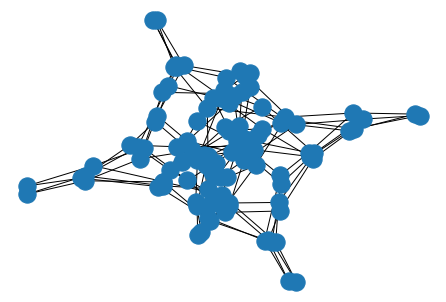

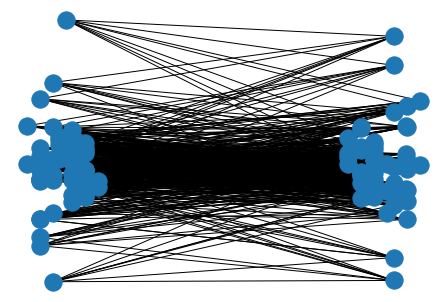

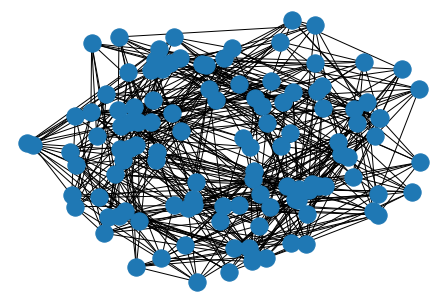

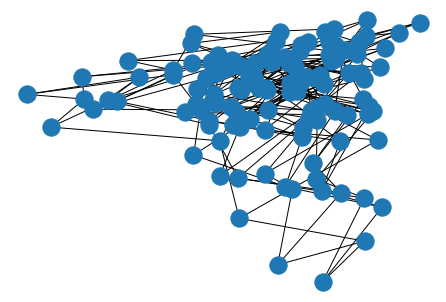

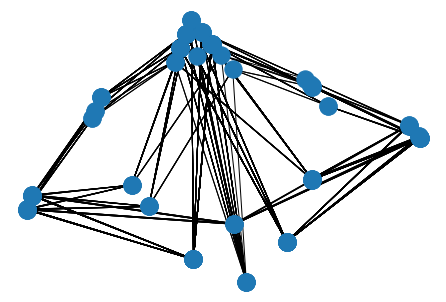

...

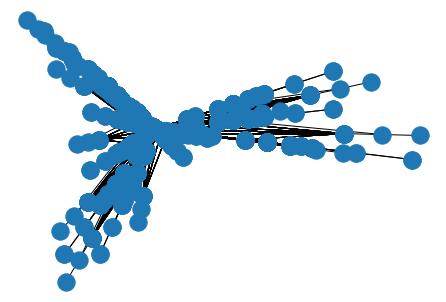

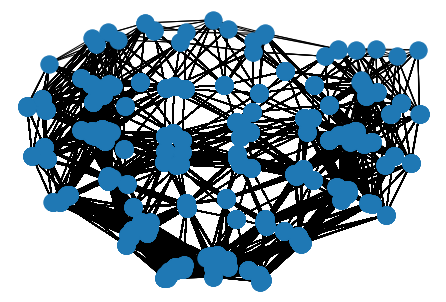

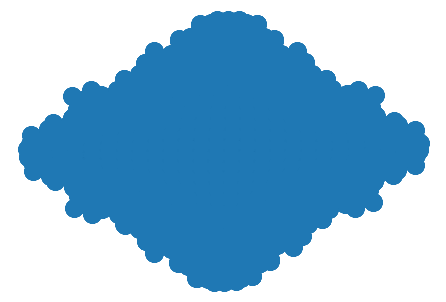

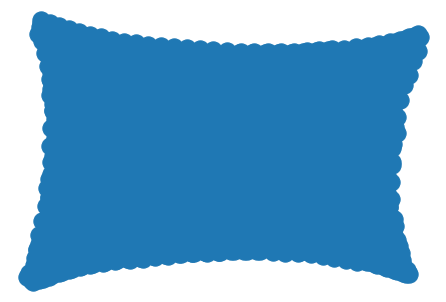

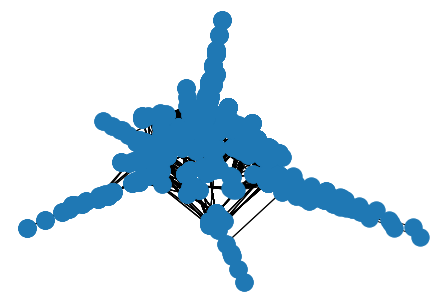

In [98]:
for idx, row in tqdm(scalability.iterrows(), total=len(scalability)):
    G = load_mtx(row['file'])
    layout = get_pmds_layout(G)
    pickle.dump(layout, open(f"layouts/new_large_graph/pmds/{row['name']}.pkl", "wb"))
    nx.draw(G, layout)
    plt.show()

  0%|          | 0/24 [00:00<?, ?it/s]

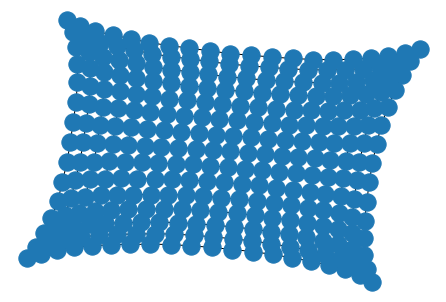

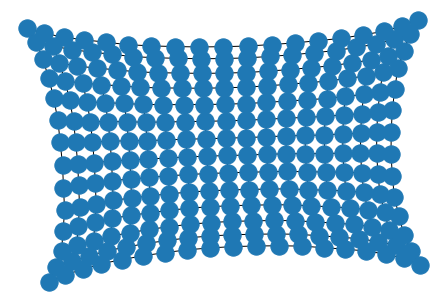

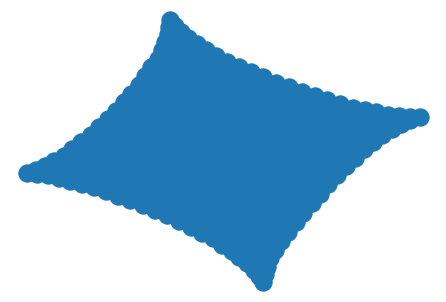

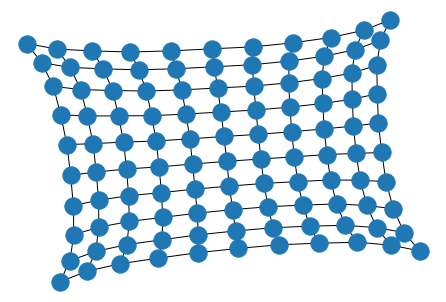

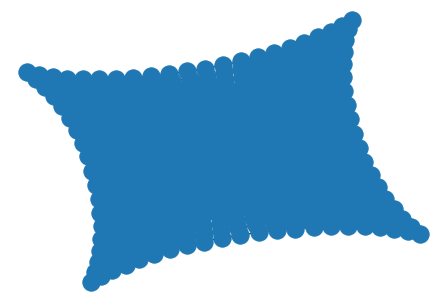

...

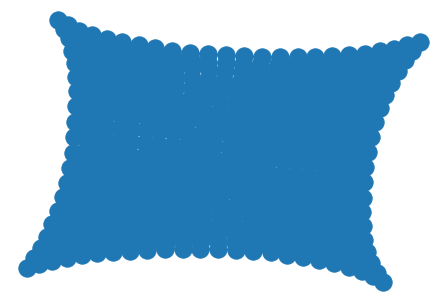

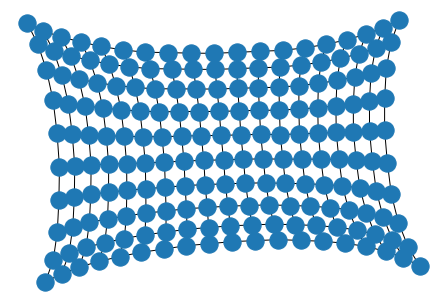

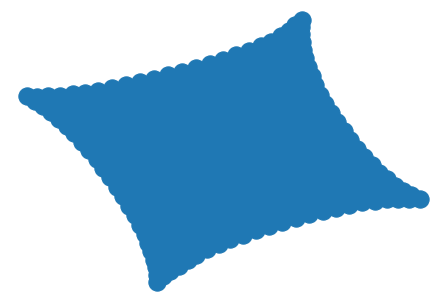

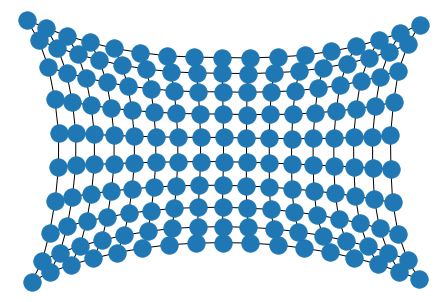

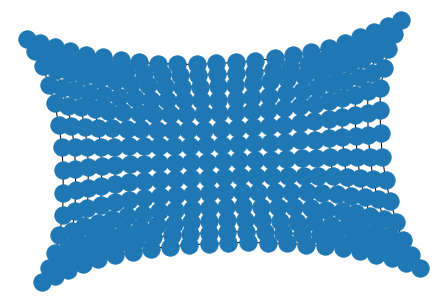

In [141]:
for file in tqdm(glob.glob("data/grid/*.pkl")):
    G = pickle.load(open(file, 'rb'))
    layout = get_pmds_layout(nx.Graph(G.edges))
    pickle.dump(layout, open(f"layouts/grid/pmds/{os.path.basename(file)}", "wb"))
    nx.draw(G, layout)
    plt.show()

  0%|          | 0/24 [00:00<?, ?it/s]

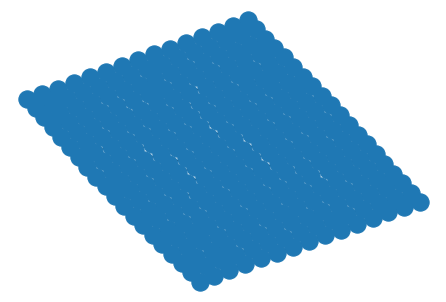

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [121.85177574099446, 109.91464314441947], expected two doubles
Error: node 1, position [151.35160797630752, 129.02140066191862], expected two doubles
Error: node 19, position [141.88188673364516, 142.60668059564026], expected two doubles
Error: node 2, position [189.23377339110496, 145.5256262453489], expected two doubles
Error: node 20, position [174.44036268264625, 158.26247838869554], expected two doubles
Error: node 3, position [227.50120053011278, 158.3951402838987], expected two doubles
Error: node 21, position [207.9104507935509, 176.68392339390437], expected two doubles
Error: node 4, position [270.9821687160827, 169.7528347468189], expected two doubles
Error: node 22, position [245.11903482467162, 189.13129263312845], expected two doubles
Error: node 5, position [316.991464714745, 179.35975445308122], expected two doubles
Error: node 23, position [285.22573310930

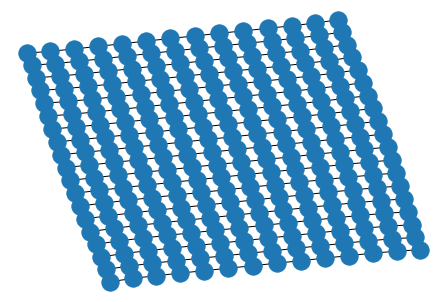

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [202.76629626808267, 109.85001002024154], expected two doubles
Error: node 1, position [224.6751335944776, 125.38370651652447], expected two doubles
Error: node 24, position [217.39767968303894, 130.69182256762232], expected two doubles
Error: node 2, position [244.86656821999026, 136.9531527366487], expected two doubles
Error: node 25, position [233.9846643949532, 148.7205120115249], expected two doubles
Error: node 3, position [268.9441025828242, 149.83986679306815], expected two doubles
Error: node 26, position [256.0658308847662, 158.16333242715248], expected two doubles
Error: node 4, position [296.69163399788624, 157.80825665068744], expected two doubles
Error: node 27, position [279.5716668421401, 167.54888606415503], expected two doubles
Error: node 5, position [317.3723358767433, 167.41084908615056], expected two doubles
Error: node 28, position [304.326596325863

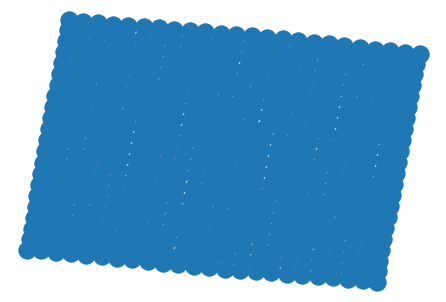

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [159.91113061183287, 128.821940090422], expected two doubles
Error: node 11, position [133.35512405138465, 158.28919588076485], expected two doubles
Error: node 2, position [228.67036149807484, 154.76044107829506], expected two doubles
Error: node 12, position [188.41058497983826, 186.15344026016166], expected two doubles
Error: node 3, position [308.11783655872944, 170.2568559252399], expected two doubles
Error: node 13, position [251.15698925989216, 207.63485228245503], expected two doubles
Error: node 4, position [396.87572540088604, 179.6886878220177], expected two doubles
Error: node 14, position [326.13057775248, 223.10074900832217], expected two doubles
Error: node 5, position [487.9235817924998, 183.81613863396706], expected two doubles
Error: node 15, position [407.34743518745177, 231.4945821593359], ex

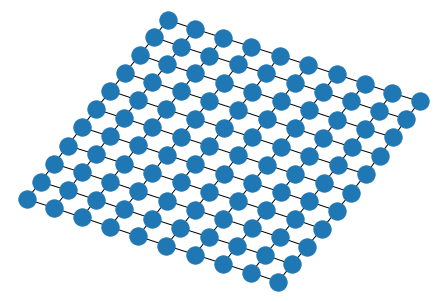

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [168.3530192652437, 117.2108839512314], expected two doubles
Error: node 1, position [194.45591775232668, 132.05296385749463], expected two doubles
Error: node 22, position [187.21285705156504, 137.90765715294003], expected two doubles
Error: node 2, position [223.56900102256446, 141.4937567302379], expected two doubles
Error: node 23, position [216.17926470416518, 154.76861646155524], expected two doubles
Error: node 3, position [247.94248887285272, 167.2082078869604], expected two doubles
Error: node 24, position [236.90387754117936, 165.7953425402928], expected two doubles
Error: node 4, position [284.4476710598173, 171.99226498410223], expected two doubles
Error: node 25, position [264.0462833953315, 184.45276007182312], expected two doubles
Error: node 5, position [324.41781564930454, 180.43831615733126], expected two doubles
Error: node 26, position [293.35104378695

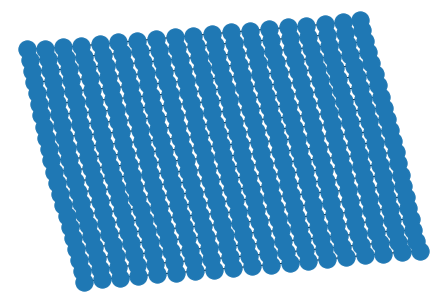

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [135.52585020633464, 118.88154393567476], expected two doubles
Error: node 20, position [124.79675310240467, 144.63802950364686], expected two doubles
Error: node 2, position [170.78030529075966, 133.61519190728768], expected two doubles
Error: node 21, position [158.46035542175997, 160.00365139334298], expected two doubles
Error: node 3, position [207.4854814136662, 146.36837221405656], expected two doubles
Error: node 22, position [195.28868407789898, 173.71501084608974], expected two doubles
Error: node 4, position [254.45533276135518, 160.9483377969205], expected two doubles
Error: node 23, position [232.06750105926776, 186.45519220364113], expected two doubles
Error: node 5, position [302.47912386339294, 171.2310172705333], expected two doubles
Error: node 24, position [270.6101488370465, 197.24614040432323

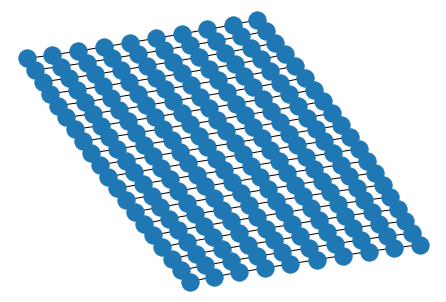

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [184.880473132361, 100.0], expected two doubles
Error: node 1, position [206.8458198421428, 113.72661486431417], expected two doubles
Error: node 23, position [200.43277125349783, 127.86747056279759], expected two doubles
Error: node 2, position [234.26527266273195, 129.79124567749537], expected two doubles
Error: node 24, position [225.53580802163202, 142.45160290882166], expected two doubles
Error: node 3, position [264.940483192152, 142.39369356270294], expected two doubles
Error: node 25, position [251.8304207502141, 156.384124176172], expected two doubles
Error: node 4, position [297.8827324444053, 153.0083160245738], expected two doubles
Error: node 26, position [279.858182813711, 169.6437987907524], expected two doubles
Error: node 5, position [332.0094407827718, 162.843010188846], expected two doubles
Error: node 27, position [311.90102972967935, 179.1578374584759

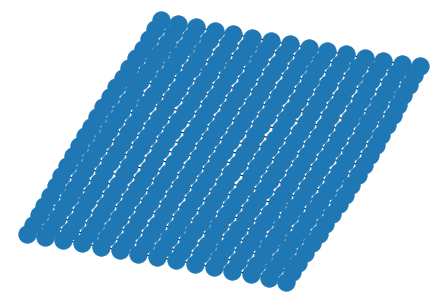

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.76463337563438, 108.72663046065445], expected two doubles
Error: node 1, position [129.35340490879724, 124.47387464651362], expected two doubles
Error: node 22, position [120.96567771873642, 143.6864807440052], expected two doubles
Error: node 2, position [164.78828690865163, 141.64190632341172], expected two doubles
Error: node 23, position [152.37935474816436, 159.8411213872078], expected two doubles
Error: node 3, position [200.81987582758964, 153.22300639567885], expected two doubles
Error: node 24, position [183.8845326909506, 175.17084313902012], expected two doubles
Error: node 4, position [239.14215739240495, 165.16374839781554], expected two doubles
Error: node 25, position [217.78972035007857, 187.2664999336908], expected two doubles
Error: node 5, position [279.8965956892005, 175.7476405609072], expected two doubles
Error: node 26, position [254.9103772667

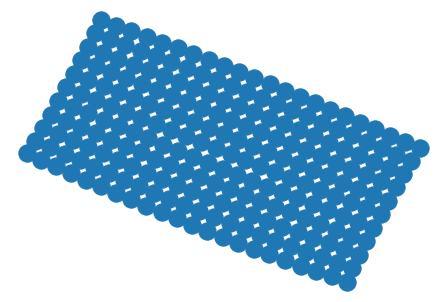

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 157.70869748254472], expected two doubles
Error: node 1, position [141.45880291299363, 175.3569684534267], expected two doubles
Error: node 18, position [120.43593099674735, 186.87442172760893], expected two doubles
Error: node 2, position [183.44772245414637, 192.62979624291737], expected two doubles
Error: node 19, position [146.04604475831627, 204.2188524586541], expected two doubles
Error: node 3, position [227.49826969474822, 205.50627235827707], expected two doubles
Error: node 20, position [183.55005462998412, 219.42875773986265], expected two doubles
Error: node 4, position [278.9791514991282, 211.6080850178202], expected two doubles
Error: node 21, position [227.23122627271374, 228.56058981255083], expected two doubles
Error: node 5, position [337.7338434367099, 212.04702785601677], expected two doubles
Error: node 22, position [279.1601909223074, 236.007

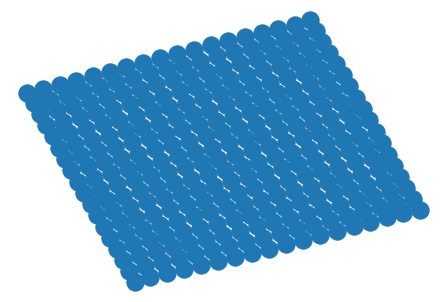

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [210.85685219114913, 100.0], expected two doubles
Error: node 1, position [227.02482290289203, 114.53042618564062], expected two doubles
Error: node 23, position [221.3627559338707, 120.90928083290434], expected two doubles
Error: node 2, position [248.77999494009057, 125.6543387098748], expected two doubles
Error: node 24, position [239.6289064503406, 135.14189985904082], expected two doubles
Error: node 3, position [272.8974173361323, 137.29496875167803], expected two doubles
Error: node 25, position [259.9955225243806, 148.19722747236682], expected two doubles
Error: node 4, position [300.31706946401505, 149.5346641139252], expected two doubles
Error: node 26, position [284.2591086851587, 161.31828370855752], expected two doubles
Error: node 5, position [330.19432345611494, 160.71071106629464], expected two doubles
Error: node 27, position [310.50422157393797, 172.3233

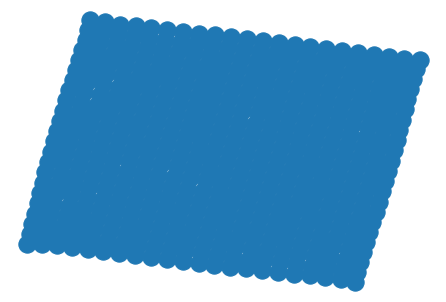

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [102.35785259869482, 100.0], expected two doubles
Error: node 1, position [140.16016407154115, 123.73436245068575], expected two doubles
Error: node 14, position [125.77765468733524, 141.65724374428083], expected two doubles
Error: node 2, position [189.76490461930496, 145.74071184289028], expected two doubles
Error: node 15, position [165.43382217103442, 163.73355636448758], expected two doubles
Error: node 3, position [247.71587813105708, 161.52276526765922], expected two doubles
Error: node 16, position [210.9455677750586, 184.76323533877314], expected two doubles
Error: node 4, position [312.55595297659437, 172.22116089596327], expected two doubles
Error: node 17, position [264.62596968726984, 198.94468781080704], expected two doubles
Error: node 5, position [381.0568884605235, 179.54145538034805], expected two doubles
Error: node 18, position [324.58732941558833, 209

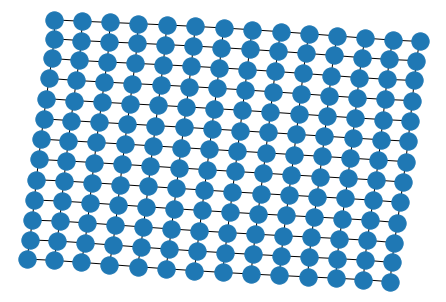

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [189.1539740460995, 100.0], expected two doubles
Error: node 1, position [215.49023163662278, 112.59035134806366], expected two doubles
Error: node 24, position [210.5317817024373, 127.51114148892667], expected two doubles
Error: node 2, position [241.2592471608772, 126.049622706822], expected two doubles
Error: node 25, position [230.95022295453828, 139.69999272195994], expected two doubles
Error: node 3, position [270.5509068470433, 130.3986072942786], expected two doubles
Error: node 26, position [250.95749395038135, 151.9298528137088], expected two doubles
Error: node 4, position [292.5145395366825, 145.97557910050315], expected two doubles
Error: node 27, position [283.4354995819135, 161.10520728420093], expected two doubles
Error: node 5, position [310.55690534194, 161.80779621826937], expected two doubles
Error: node 28, position [319.7685425801661, 174.69263669258

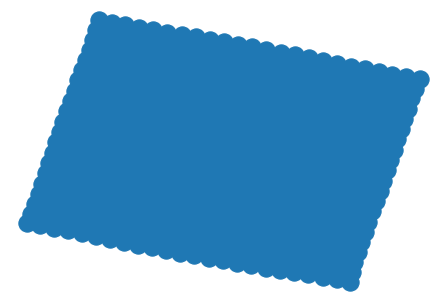

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [130.99484965103144, 122.49453058158144], expected two doubles
Error: node 15, position [119.62473812585706, 134.9835411117901], expected two doubles
Error: node 2, position [180.51206684728413, 140.33808495212347], expected two doubles
Error: node 16, position [153.36726376924133, 158.57719175835075], expected two doubles
Error: node 3, position [228.34723183334782, 156.93411939265314], expected two doubles
Error: node 17, position [198.04178906951333, 173.65197942665935], expected two doubles
Error: node 4, position [287.258205000414, 166.62078894248526], expected two doubles
Error: node 18, position [246.95703403438142, 187.2625115789228], expected two doubles
Error: node 5, position [347.9286269714582, 177.22299944944984], expected two doubles
Error: node 19, position [298.76679511048576, 198.87523191402136]

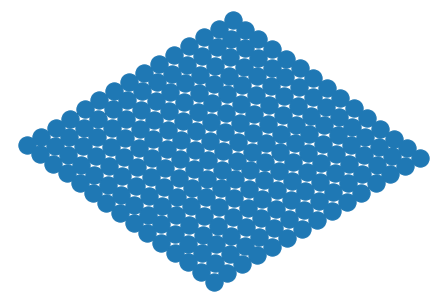

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [121.30434337314651, 101.94319034445913], expected two doubles
Error: node 1, position [147.363036228135, 115.56901308470614], expected two doubles
Error: node 22, position [140.87728916325716, 134.41763641400328], expected two doubles
Error: node 2, position [179.9823712931444, 130.71200915387124], expected two doubles
Error: node 23, position [169.4515976764904, 148.9765361613486], expected two doubles
Error: node 3, position [214.98726553654058, 143.001242516984], expected two doubles
Error: node 24, position [199.67220711031806, 164.21706241036162], expected two doubles
Error: node 4, position [253.37379116135233, 155.8758304450946], expected two doubles
Error: node 25, position [231.95753646453954, 176.17161421134062], expected two doubles
Error: node 5, position [292.6981206377435, 167.38802904164413], expected two doubles
Error: node 26, position [267.5476611708886

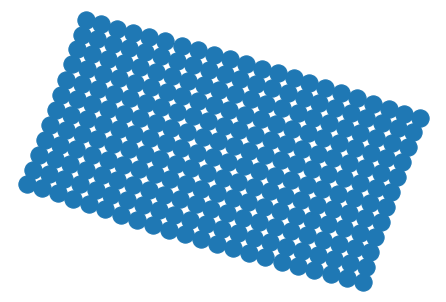

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.34856545994136, 100.0], expected two doubles
Error: node 1, position [139.6361615429056, 115.7264524820523], expected two doubles
Error: node 17, position [124.16714238358003, 129.9420567748508], expected two doubles
Error: node 2, position [175.98598347781416, 138.00773915864042], expected two doubles
Error: node 18, position [159.20648631908733, 149.23834098736666], expected two doubles
Error: node 3, position [219.4175397678834, 153.8138381488469], expected two doubles
Error: node 19, position [196.03577717550849, 166.67372839493385], expected two doubles
Error: node 4, position [267.6611958066434, 166.53092882604113], expected two doubles
Error: node 20, position [236.31231731698657, 180.25303037086252], expected two doubles
Error: node 5, position [322.0581723252044, 174.3070251089843], expected two doubles
Error: node 21, position [282.5699114185748, 192.488904

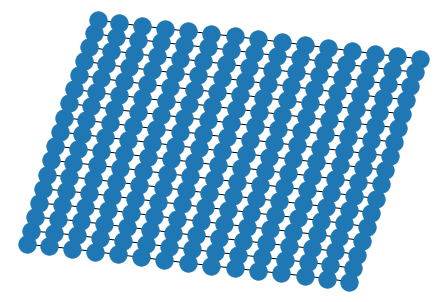

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [160.9802446872923, 135.22640964888785], expected two doubles
Error: node 10, position [133.40725751796478, 164.2973045461208], expected two doubles
Error: node 2, position [240.76192402415, 159.78736275376951], expected two doubles
Error: node 11, position [191.58174059835346, 196.68406150435368], expected two doubles
Error: node 3, position [330.6545525656786, 170.7250289411107], expected two doubles
Error: node 12, position [262.312676984178, 217.00316918574543], expected two doubles
Error: node 4, position [428.35179650654027, 174.52746262519798], expected two doubles
Error: node 13, position [344.2166128932487, 225.9581641006438], expected two doubles
Error: node 5, position [533.6908299862438, 174.6042015391326], expected two doubles
Error: node 14, position [436.26155639857933, 233.3008260226044], expecte

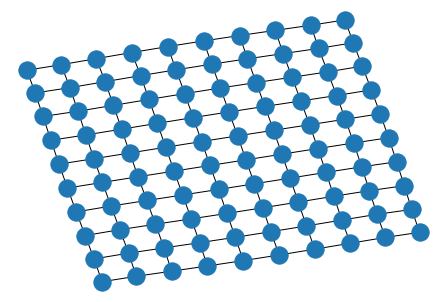

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [102.0538326343584, 100.64132778642687], expected two doubles
Error: node 1, position [155.7469698306448, 129.24759301492705], expected two doubles
Error: node 11, position [131.2901637927974, 154.6683953070533], expected two doubles
Error: node 2, position [227.44440667109922, 154.39815602478706], expected two doubles
Error: node 12, position [183.95149778511671, 184.35000262168552], expected two doubles
Error: node 3, position [307.3696410649577, 168.8125775249236], expected two doubles
Error: node 13, position [250.97374808728432, 202.9710014952463], expected two doubles
Error: node 4, position [393.23644904593664, 178.36947448000083], expected two doubles
Error: node 14, position [325.72929032290466, 218.37777987546997], expected two doubles
Error: node 5, position [484.6961269037016, 182.14644710628016], expected two doubles
Error: node 15, position [405.293178710854

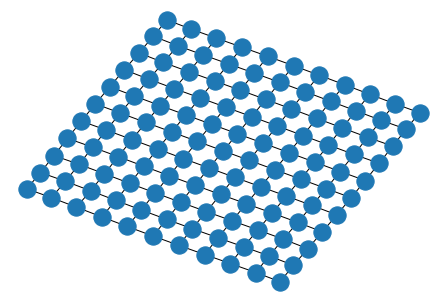

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [151.37714619874077, 129.3811516843149], expected two doubles
Error: node 12, position [131.7521450301076, 149.39829023514332], expected two doubles
Error: node 2, position [218.95430085020104, 153.61775258873186], expected two doubles
Error: node 13, position [181.04583451809702, 178.9725212890064], expected two doubles
Error: node 3, position [297.196306932887, 170.90876409473577], expected two doubles
Error: node 14, position [243.08589145648014, 202.17939484516256], expected two doubles
Error: node 4, position [381.12770873200117, 181.12010542625484], expected two doubles
Error: node 15, position [313.8942389742066, 218.3267483848017], expected two doubles
Error: node 5, position [468.292730151092, 183.92556810425634], expected two doubles
Error: node 16, position [391.6619899589217, 228.1358414048733], expe

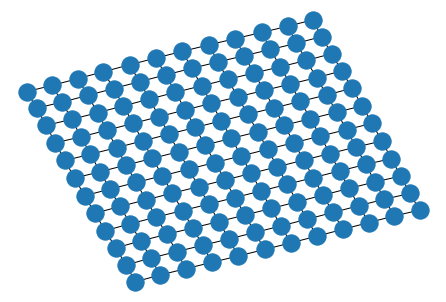

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [207.32040894669723, 113.3168738010672], expected two doubles
Error: node 1, position [229.71993205422783, 130.86048539563166], expected two doubles
Error: node 20, position [223.66443301886085, 139.16088213652813], expected two doubles
Error: node 2, position [258.97914777371045, 146.13277775212458], expected two doubles
Error: node 21, position [246.7404183517278, 156.950823418041], expected two doubles
Error: node 3, position [290.6458091259657, 158.80662185166884], expected two doubles
Error: node 22, position [273.17542531980706, 171.0486473445314], expected two doubles
Error: node 4, position [324.468002963073, 169.6501417829768], expected two doubles
Error: node 23, position [303.79713834989536, 182.78835001849365], expected two doubles
Error: node 5, position [358.66746943444167, 178.75769859728118], expected two doubles
Error: node 24, position [335.801542167048,

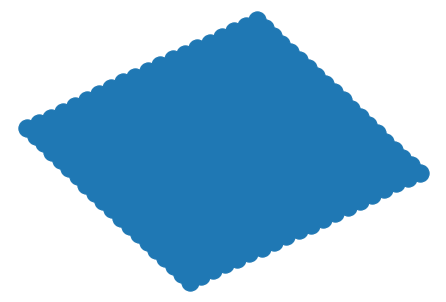

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [183.4463909453854, 100.0], expected two doubles
Error: node 1, position [202.63019961090887, 118.2408704617755], expected two doubles
Error: node 24, position [196.5285349744981, 127.73700918022112], expected two doubles
Error: node 2, position [228.0685725817928, 133.61693974632948], expected two doubles
Error: node 25, position [218.839960534035, 144.81116070678019], expected two doubles
Error: node 3, position [256.2793075684896, 148.21651116460035], expected two doubles
Error: node 26, position [242.1040724109578, 160.25408432636164], expected two doubles
Error: node 4, position [286.3870003628469, 159.5924477314628], expected two doubles
Error: node 27, position [267.306670055558, 172.78373406106317], expected two doubles
Error: node 5, position [318.12183070970804, 169.38220936395075], expected two doubles
Error: node 28, position [294.60241915146077, 183.287538149

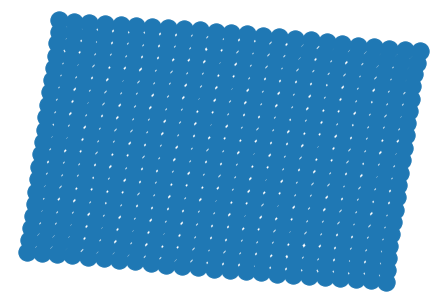

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [136.19466257045764, 119.79114957849504], expected two doubles
Error: node 19, position [124.33615489339807, 145.89275557727302], expected two doubles
Error: node 2, position [172.9106051324361, 135.33872147073066], expected two doubles
Error: node 20, position [161.11270669217583, 162.35935007869003], expected two doubles
Error: node 3, position [212.23159437438565, 148.30658098536182], expected two doubles
Error: node 21, position [198.83675204218792, 176.72520139344306], expected two doubles
Error: node 4, position [262.12963460139076, 162.68943105770583], expected two doubles
Error: node 22, position [237.38950854784355, 190.21787418685102], expected two doubles
Error: node 5, position [313.4182238766514, 173.797946796801], expected two doubles
Error: node 23, position [278.0925468829167, 200.5683263212448],

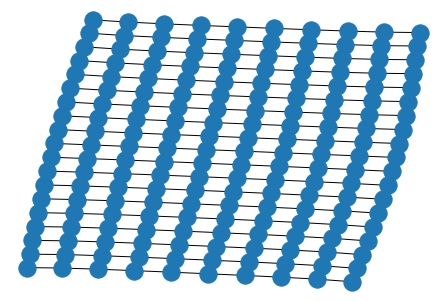

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [100.0, 100.0], expected two doubles
Error: node 1, position [121.02438076802041, 115.42993862327458], expected two doubles
Error: node 24, position [114.2825149854586, 119.36303138167877], expected two doubles
Error: node 2, position [144.24987377663115, 128.17804653078613], expected two doubles
Error: node 25, position [135.81916657492621, 136.08193756888062], expected two doubles
Error: node 3, position [167.01689906856154, 139.85348313507404], expected two doubles
Error: node 26, position [157.057976680215, 144.85283501609047], expected two doubles
Error: node 4, position [197.82342457102314, 147.32357988618685], expected two doubles
Error: node 27, position [182.27328227482434, 158.4048603329068], expected two doubles
Error: node 5, position [226.9603456707075, 161.23275264405842], expected two doubles
Error: node 28, position [211.38855480909191, 168.5795494979397],

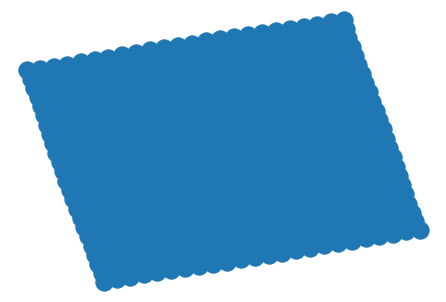

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [102.17649148247553, 100.0], expected two doubles
Error: node 1, position [138.61124522940906, 123.04412763228967], expected two doubles
Error: node 17, position [128.9413667846967, 147.61567928847296], expected two doubles
Error: node 2, position [184.1423743688894, 142.955823513408], expected two doubles
Error: node 18, position [164.40369633207072, 169.28313273073493], expected two doubles
Error: node 3, position [233.69081677334364, 158.2995372436082], expected two doubles
Error: node 19, position [207.7861549436792, 186.33464489281795], expected two doubles
Error: node 4, position [285.41853483996067, 170.87669688237673], expected two doubles
Error: node 20, position [253.68435722306234, 199.86045543571913], expected two doubles
Error: node 5, position [339.6890224547695, 180.27508831658164], expected two doubles
Error: node 21, position [302.56274428319847, 210.3753

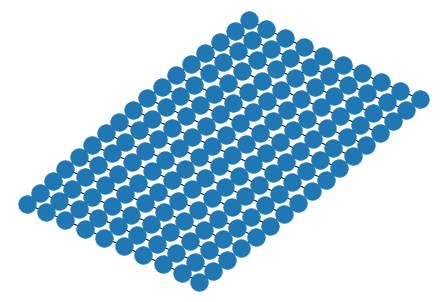

/usr/local/anaconda3/lib/python3.8/site-packages/pygraphviz/agraph.py:1390: RuntimeWarning: Error: node 0, position [165.04240283751426, 100.0], expected two doubles
Error: node 1, position [190.44589630893802, 117.00422620849542], expected two doubles
Error: node 23, position [185.43763832545642, 130.06899689191738], expected two doubles
Error: node 2, position [220.06830041974018, 133.29582392486174], expected two doubles
Error: node 24, position [210.0944267134057, 146.82531198989687], expected two doubles
Error: node 3, position [252.2136875372187, 142.70117076802867], expected two doubles
Error: node 25, position [239.21289373778995, 158.8335318223048], expected two doubles
Error: node 4, position [286.13742153070996, 151.6455089231213], expected two doubles
Error: node 26, position [269.7588875971254, 168.77029411013982], expected two doubles
Error: node 5, position [321.5553370991357, 161.75095862820174], expected two doubles
Error: node 27, position [302.1324752103835, 177.9237

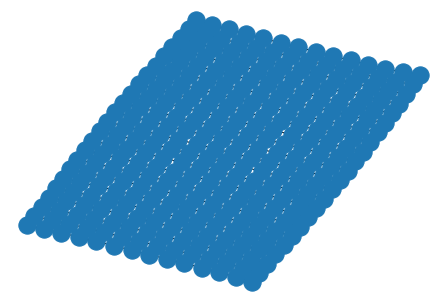

In [187]:
for file in tqdm(glob.glob("data/grid/*.pkl")):
    G = pickle.load(open(file, 'rb'))
    layout = nx.nx_agraph.graphviz_layout(G, prog='neato')
    pickle.dump(layout, open(f"layouts/grid/gviz/{os.path.basename(file)}", "wb"))
    nx.draw(G, layout)
    plt.show()

In [166]:
grid_files = sorted(glob.glob("data/grid/*.pkl"), key=lambda f: tuple(map(int, re.findall('\d+', f))))

In [179]:
pos = []
for file in grid_files:
    name = os.path.basename(file)
    layout = pickle.load(open(f"layouts/grid/pmds/{name}", "rb"))
    sorted_layout = dict(sorted(layout.items(), key=lambda pair: pair[0]))
    pos.append(np.array(list(sorted_layout.values())))
np.save("layouts/grid/pos_pmds.npy", pos)

In [188]:
pos = []
for file in grid_files:
    name = os.path.basename(file)
    layout = pickle.load(open(f"layouts/grid/gviz/{name}", "rb"))
    sorted_layout = dict(sorted(layout.items(), key=lambda pair: pair[0]))
    pos.append(np.array(list(sorted_layout.values())))
np.save("layouts/grid/pos_gviz.npy", pos)

/usr/local/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


In [184]:
pos = []
for idx, row in tqdm(scalability.iterrows(), total=len(scalability)):
    layout = pickle.load(open(f"layouts/new_large_graph/pmds/{row['name']}.pkl", "rb"))
    sorted_layout = dict(sorted(layout.items(), key=lambda pair: pair[0]))
    pos.append(np.array(list(sorted_layout.values())))

  0%|          | 0/537 [00:00<?, ?it/s]

In [185]:
np.save("layouts/new_large_graph/pos_pmds.npy", pos)

/usr/local/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


In [139]:
subprocess.check_output(['hde/pmds'], text=True, input=indot)

'strict graph {\n\t0\t[pos="704.517773,464.016262"];\n\t1\t[pos="651.092628,447.687520"];\n\t0 -- 1;\n\t20\t[pos="670.625255,413.386450"];\n\t0 -- 20;\n\t2\t[pos="593.442703,433.276994"];\n\t1 -- 2;\n\t21\t[pos="618.252661,398.098148"];\n\t1 -- 21;\n\t20 -- 21;\n\t40\t[pos="643.752107,347.715875"];\n\t20 -- 40;\n\t3\t[pos="531.528637,424.682401"];\n\t2 -- 3;\n\t22\t[pos="562.514128,384.859774"];\n\t2 -- 22;\n\t21 -- 22;\n\t41\t[pos="592.520368,334.865451"];\n\t21 -- 41;\n\t4\t[pos="466.473128,418.715577"];\n\t3 -- 4;\n\t23\t[pos="502.738003,376.910722"];\n\t3 -- 23;\n\t22 -- 23;\n\t42\t[pos="538.114947,323.575564"];\n\t22 -- 42;\n\t5\t[pos="397.550269,417.508193"];\n\t4 -- 5;\n\t24\t[pos="440.250738,371.441710"];\n\t4 -- 24;\n\t23 -- 24;\n\t43\t[pos="479.898480,317.048385"];\n\t23 -- 43;\n\t6\t[pos="326.482205,417.917738"];\n\t5 -- 6;\n\t25\t[pos="374.490495,370.606649"];\n\t5 -- 25;\n\t24 -- 25;\n\t44\t[pos="419.401177,312.853520"];\n\t24 -- 44;\n\t7\t[pos="253.327684,422.879104"];\n\

In [74]:
G = load_mtx(files[1])

In [75]:
layout = get_pmds_layout(G)

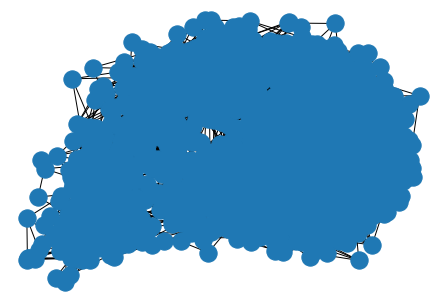

In [76]:
nx.draw(G, layout)

In [8]:
G_list = load_G_list(data_path='data/rome', index_file='deepgd/data_index.txt', cache='G_list.pickle')

NameError: name 'load_G_list' is not defined

In [16]:
pmds_G_list = []
for i in tqdm(range(len(G_list))):
    dot_path = f'rome_dot/{i}.dot'
    pmds_path = f'rome_dot/{i}.pmds.dot'
    nx.drawing.nx_agraph.write_dot(G_list[i], dot_path)
    subprocess.run([f'hde/pmds'], text=True, stdin=open(dot_path), stdout=open(pmds_path, 'w'))
    pmds_G_list.append(nx.drawing.nx_agraph.read_dot(pmds_path))

In [32]:
pmds_list = []
for pmds_G in tqdm(pmds_G_list):
    pmds_list.append(np.array([list(map(float, pmds_G.nodes[str(i)]['pos'].split(','))) for i in range(pmds_G.number_of_nodes())]))

In [36]:
pickle.dump(pmds_list, open('pmds_list.pickle', 'wb'))

In [14]:
Batch.from_data_list([Data(sparsity=torch.tensor([[0.5, 0.5, 0.5]])), Data(sparsity=torch.tensor([[0.5, 0.5, 0.5]]))]).sparsity.shape[1]

3